# Traitement d'images : filtrage, seuillage, et comptage d'objets avec opencv

Une initiation à la biblithèque opencv 

# Veille technologique: Opencv python

-  Suivre les instructions et faire une recherche selon ce qui est demandé.

## Operations Simples

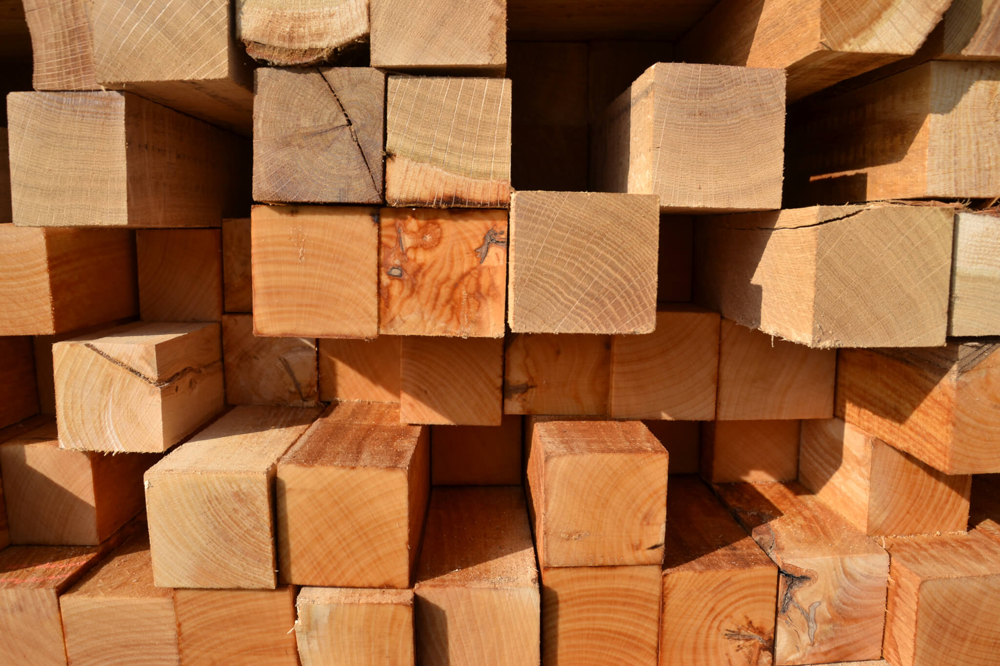

In [2]:
# use opencv to load and display the image
import cv2
import matplotlib.pyplot as plt
import numpy as np
# import skimage as sk
# from skimage.io import imread, imshow, imsave

from PIL import Image, ImageFilter
from IPython.display import display

# lire l'image (avec imread)
image = Image.open('./res/bois.png')
# afficher image
display(image)

In [3]:
# afficher la taille de l'image
pixels = np.array(image)
print(pixels.shape)

(1365, 2048, 3)


In [4]:
# l'image a trois couleur R,G,B. afficher les valeurs des trois couleurs pour le pixel x = 150, et y = 100
print(pixels[150, 100])

[228 181 137]


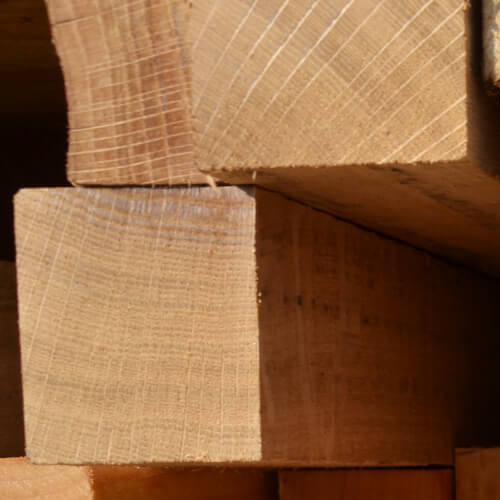

In [5]:
# Crop une partie de l'image (sélectionner une petite partie à partir des coordonnées)
cropped = pixels[:500, :500]
display(Image.fromarray(cropped))

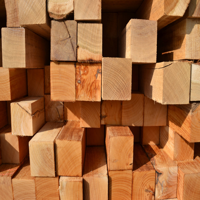

In [6]:
# redimensioner l'image à 200x200 pixels
resized = image.resize((200, 200))
# afficher resized
display(resized)

# qu'est ce que vous remarquez !!
# > on a perdu de l'information inutiles: nous avons fait du feature extraction

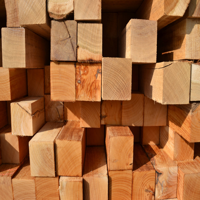

In [7]:
# redimensinner sans affecter l'image
display(image.resize((200, 200)))

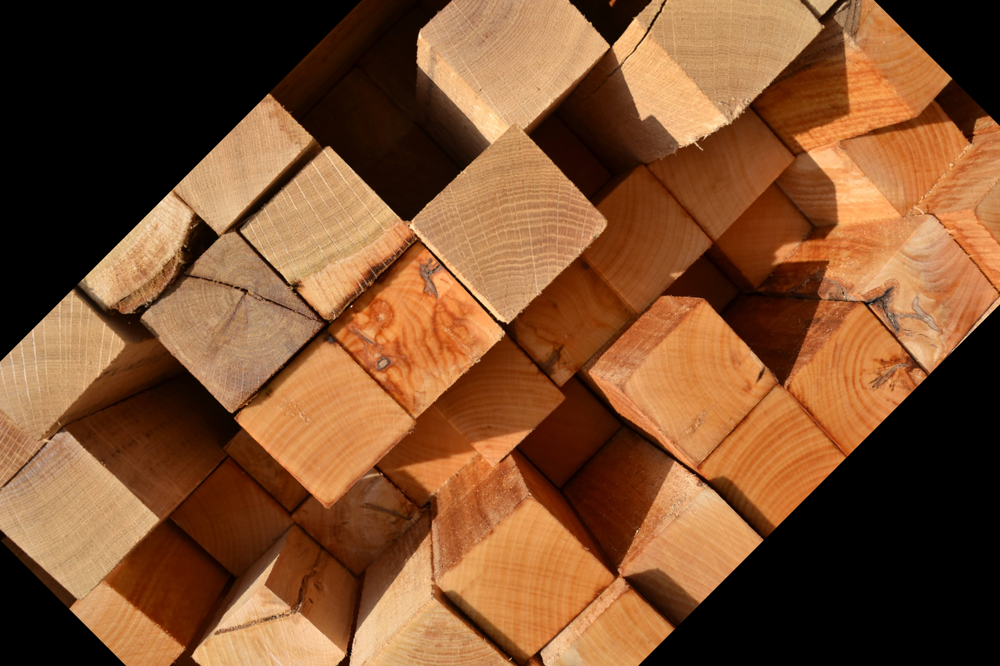

In [8]:
# faire tourner une image -45°
rotated = image.rotate(45)
display(rotated)

Vous pouvez utiliser la bibliothèque imutils pour faire les rotations et d'autres fonctions facilement. Pour l'instaler: pip install imutils

# Dessiner sur l'image

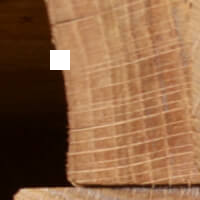

In [9]:
# dessiner un rectangle
copy = pixels[:200, :200].copy()
copy[50:70, 50:70] = (255, 255, 255)
display(Image.fromarray(copy))

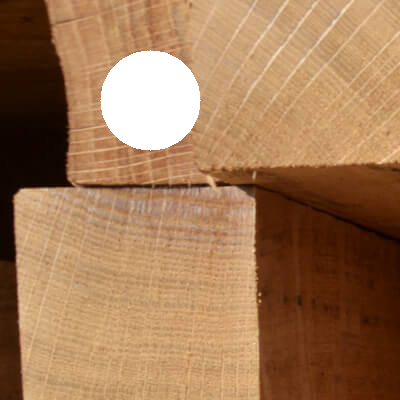

In [10]:
# dessiner un circle
def draw_circle(img, center, radius, color):
    pixels = np.array(img, dtype=np.uint64)

    for i in range(pixels.shape[0]):
        for j in range(pixels.shape[1]):
            if (i - center[0]) ** 2 + (j - center[1]) ** 2 <= radius**2:
                pixels[i, j] = color

    return Image.fromarray(pixels.astype(np.uint8))

img_with_circle = draw_circle(pixels[:400, :400], (100, 150), 50, (255, 255, 255))
display(img_with_circle)

# Filtrage d'image

* Blur
* Gaussian blur
* Median blur
* Sharpening
* Bilateral blur
* Bilateral filtering

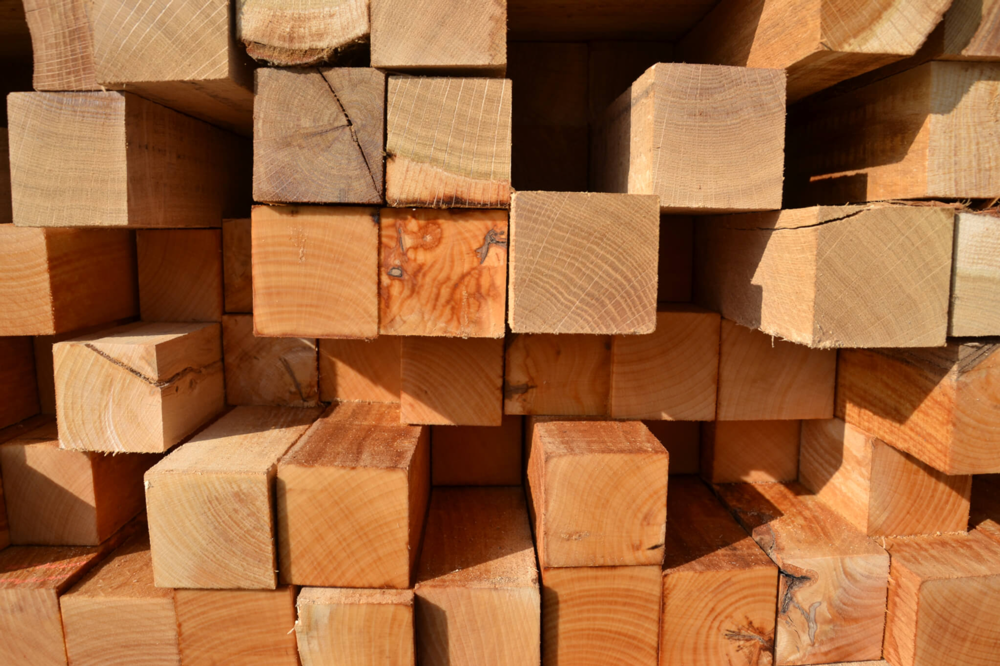

In [63]:
# Utiliser la méthode "cv2.filter2D" avec un kernel de taille 2
kernel = np.ones((2, 2), dtype=np.float32) / 4

filtered = cv2.filter2D(pixels, ddepth=-1, kernel=kernel)
display(Image.fromarray(filtered))

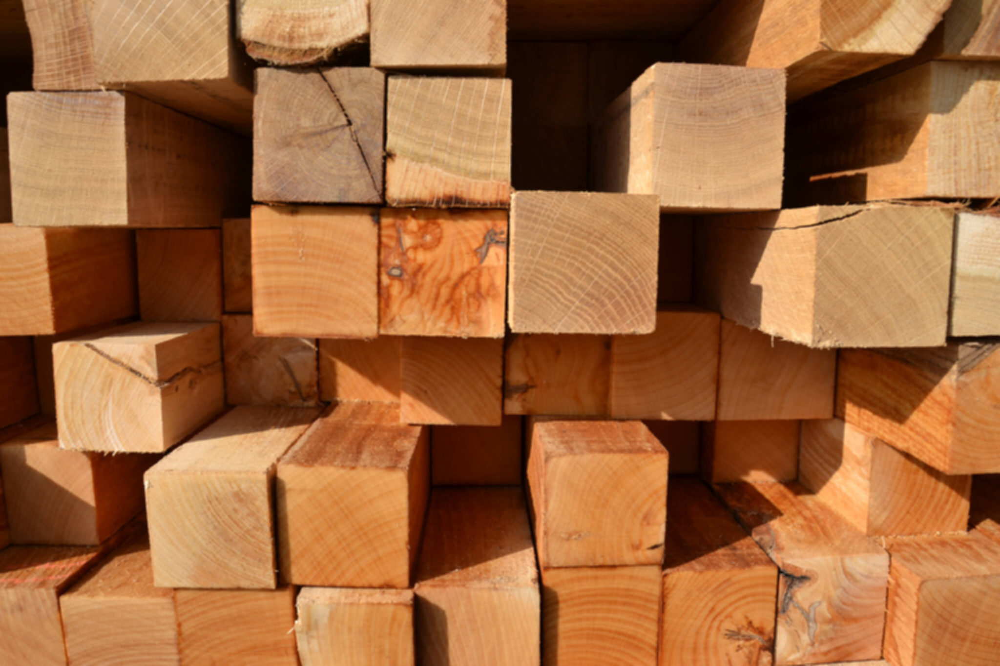

In [64]:
# Appliquer blur avec un kernel de taille 5x5
kernel = np.ones((5, 5), dtype=np.float32) / 25

filtered = cv2.filter2D(pixels, ddepth=-1, kernel=kernel)
display(Image.fromarray(filtered))

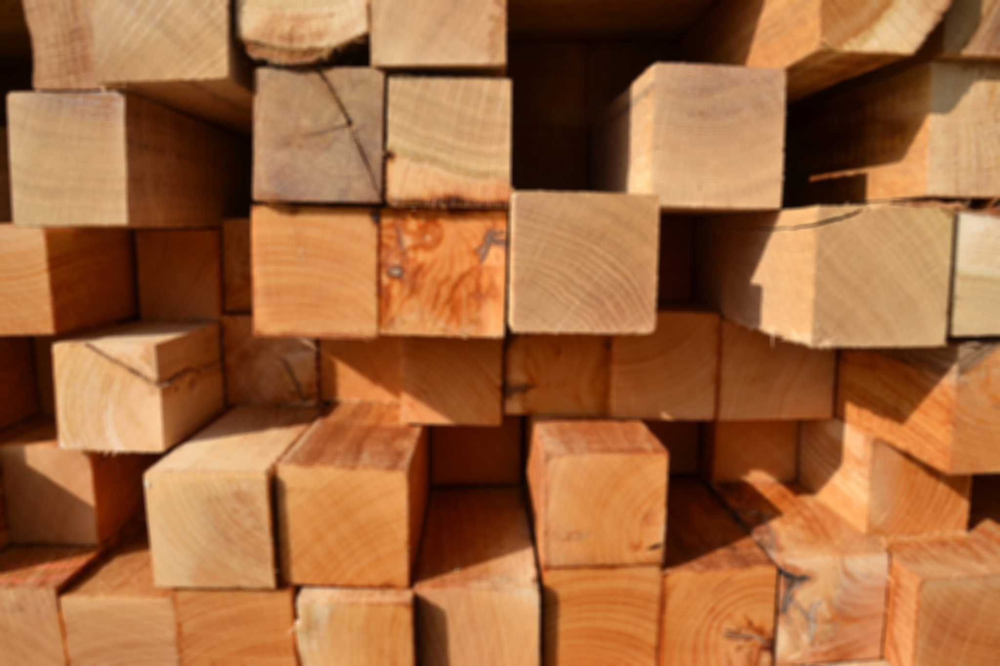

In [25]:
# gaussian blur
blurred = cv2.GaussianBlur(src=pixels, ksize=(11, 11), sigmaX=10, sigmaY=10)
display(Image.fromarray(blurred))

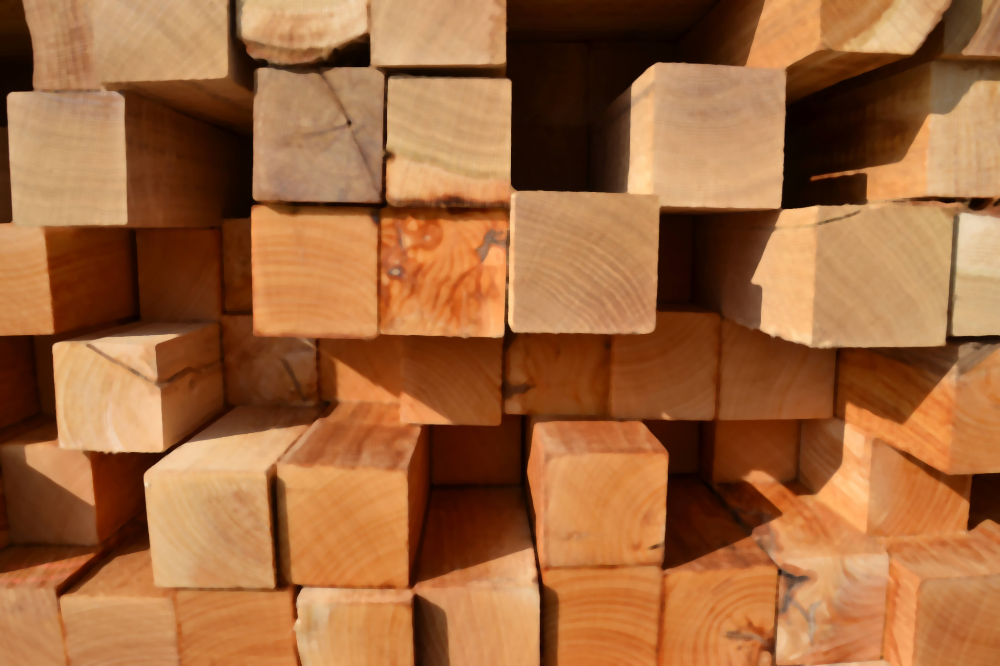

In [31]:
# median blur
median_blurred = cv2.medianBlur(src=pixels, ksize=11)
display(Image.fromarray(median_blurred))

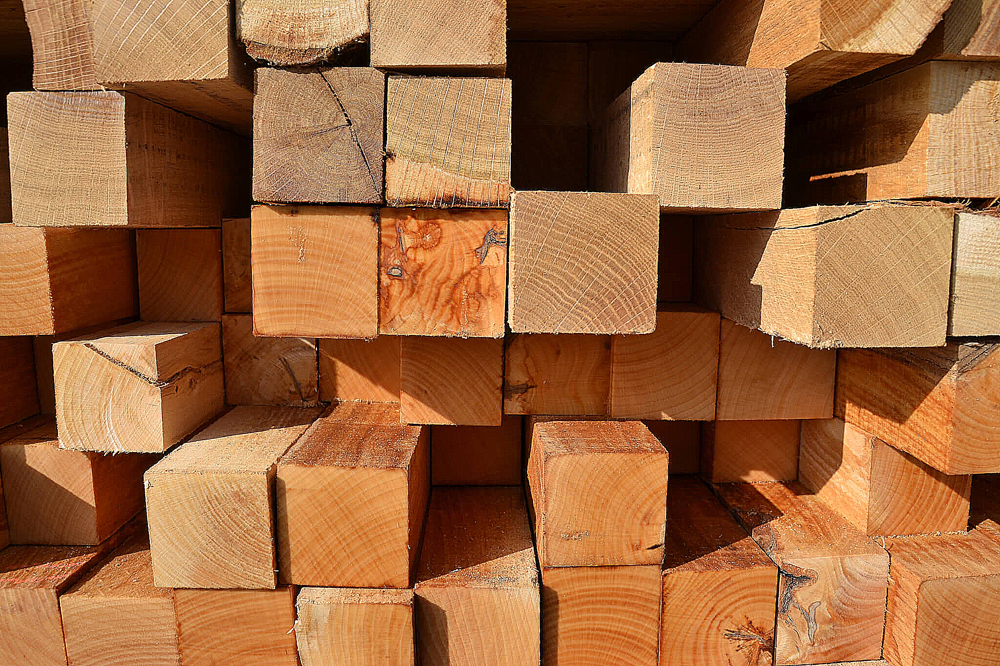

In [45]:
# sharpening
kernel = np.array([[-1, -1, -1],
                   [-1, 9, -1],
                   [-1, -1, -1]])

sharpened_image = cv2.filter2D(pixels, -1, kernel)
display(Image.fromarray(sharpened_image))

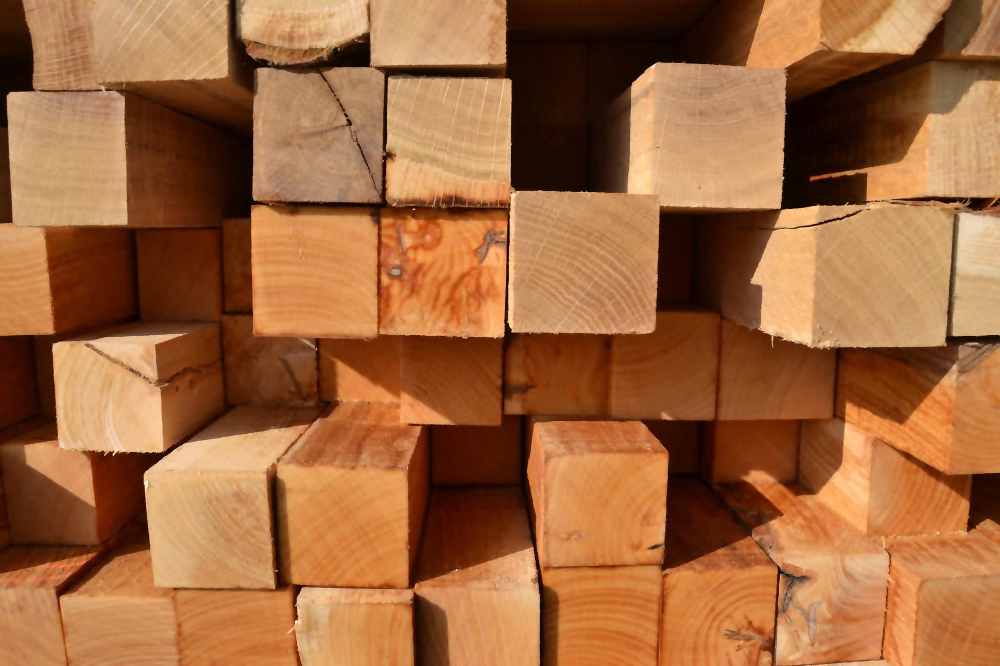

In [46]:
# bilateral filtering
bilateral_filtered_image = cv2.bilateralFilter(pixels, d=9, sigmaColor=75, sigmaSpace=75)
display(Image.fromarray(bilateral_filtered_image))

# Seuillage d'image

En utilisant l'image "sudoku" appliquer:
* Binary Thresholding
* Otsu thresholding
* Adaptive thresholding

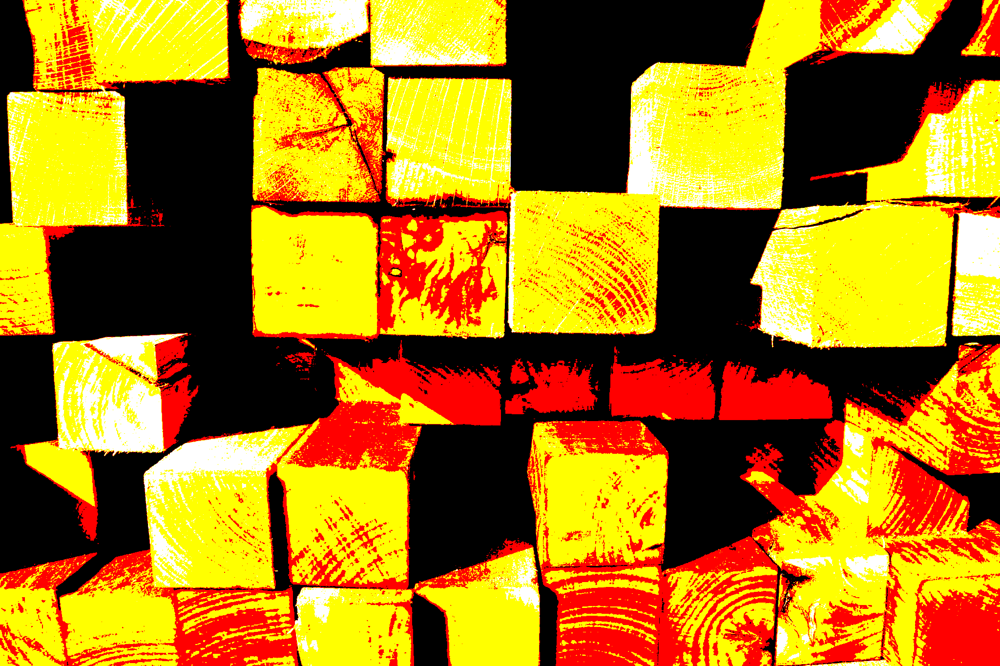

In [48]:
# appliquer un seuillage binaire d'un seuil de 127
_, binary_threshold_image = cv2.threshold(pixels, thresh=127, maxval=255, type=cv2.THRESH_BINARY)
display(Image.fromarray(binary_threshold_image))

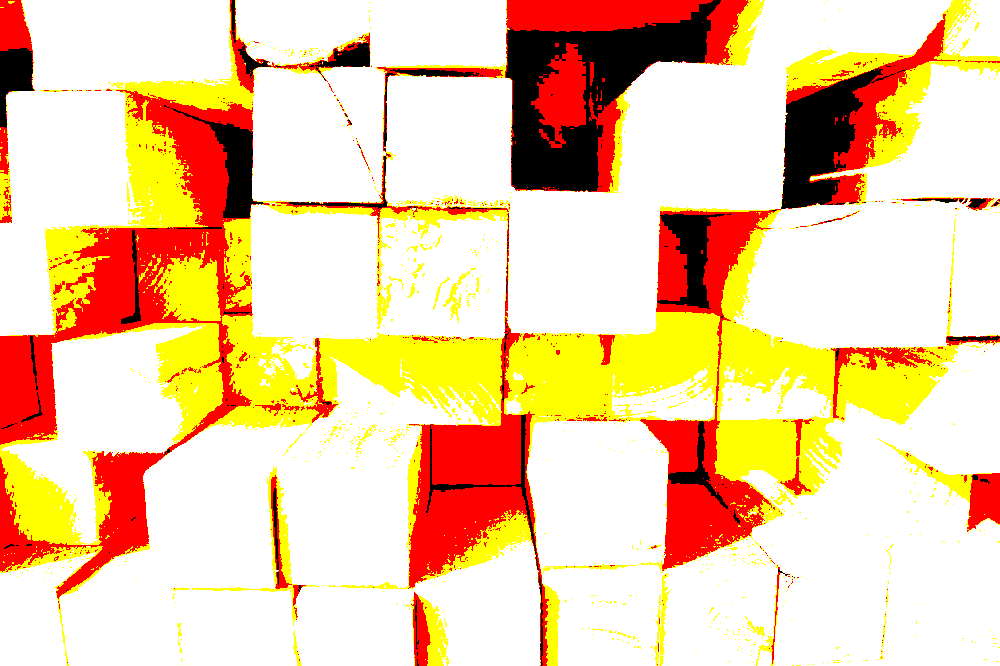

In [49]:
# appliquer un seuillage binaire d'un seuil de 30
_, binary_threshold_image = cv2.threshold(pixels, thresh=30, maxval=255, type=cv2.THRESH_BINARY)
display(Image.fromarray(binary_threshold_image))

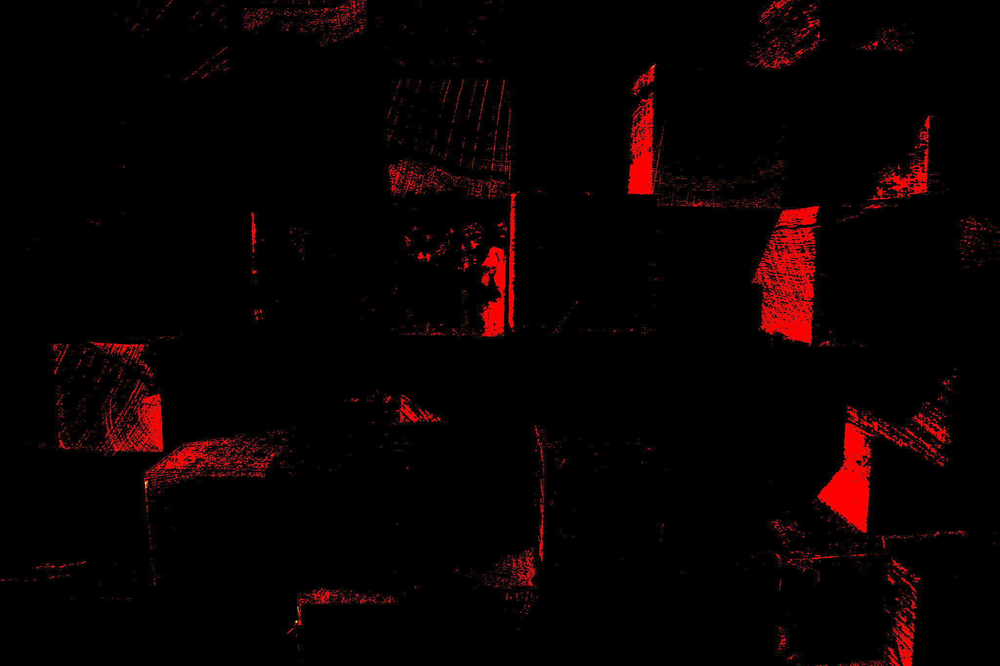

In [50]:
# appliquer un seuillage binaire d'un seuil de 240
_, binary_threshold_image = cv2.threshold(pixels, thresh=240, maxval=255, type=cv2.THRESH_BINARY)
display(Image.fromarray(binary_threshold_image))

Qu'est ce que vous remarquez ?!

In [24]:
# appliquer "Otsu" seuillage


In [25]:
# appliquer "Adaptive threshold"


# Détection des bords

* Sobel
* Canny

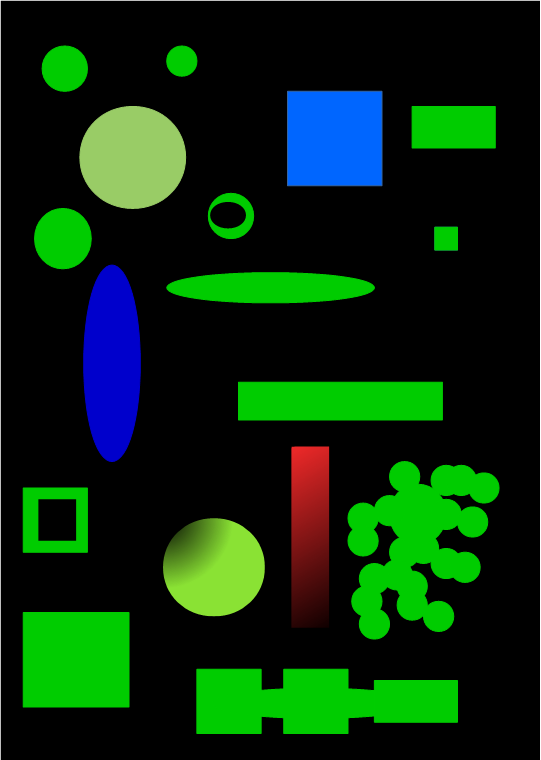

In [67]:
# utiliser la methode sobel pour détecter les bords
# Vous pouvez utiliser d'autres images de votre choix

image_01 = Image.open('./res/image_01.png')
display(image_01)

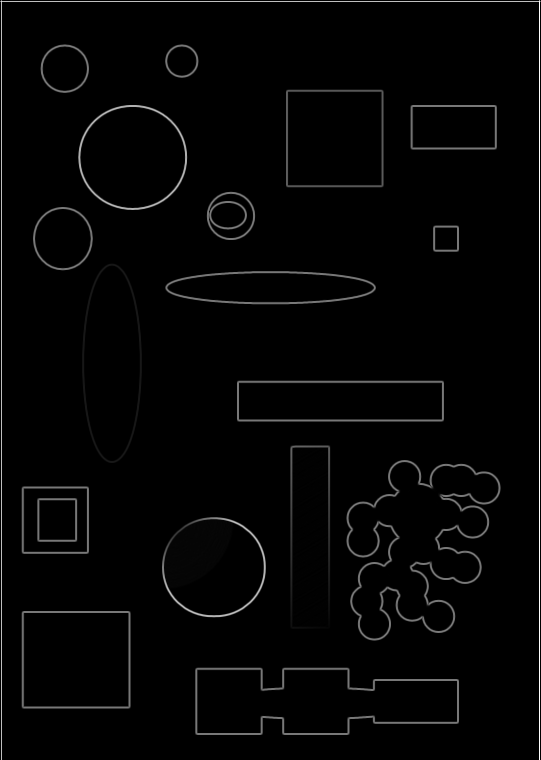

In [78]:
pixels_01 = np.array(image_01.convert('L'))

# Apply Sobel edge detection in x and y directions
sobel_x = cv2.Sobel(pixels_01, cv2.CV_64F, 1, 0, ksize=3)  # Sobel operator for x-axis
sobel_y = cv2.Sobel(pixels_01, cv2.CV_64F, 0, 1, ksize=3)  # Sobel operator for y-axis

# Combine the gradients obtained from x and y directions
sobel_combined = cv2.sqrt(cv2.add(cv2.pow(sobel_x, 2), cv2.pow(sobel_y, 2)))

# Convert the result to 8-bit image
sobel_combined = cv2.normalize(sobel_combined, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

display(Image.fromarray(sobel_combined))

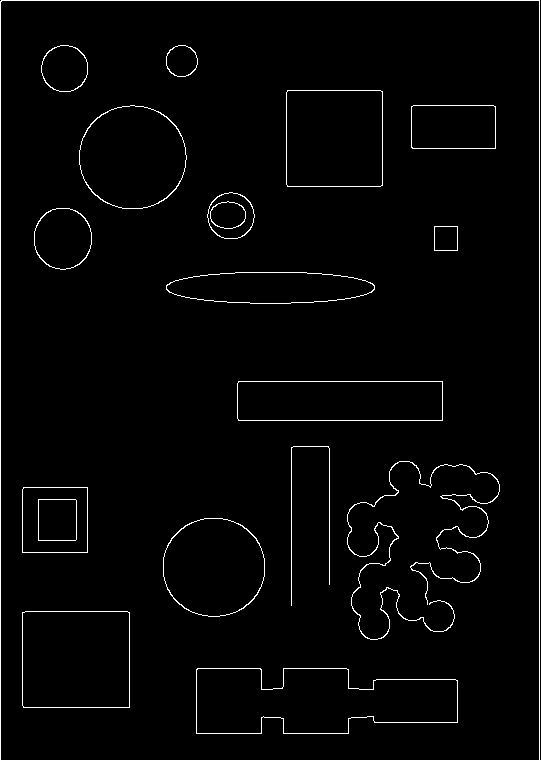

In [79]:
pixels_01 = np.array(image_01.convert('L'))

# Canny
edges = cv2.Canny(pixels_01, threshold1=100, threshold2=200)

display(Image.fromarray(edges))

# Détection des contours

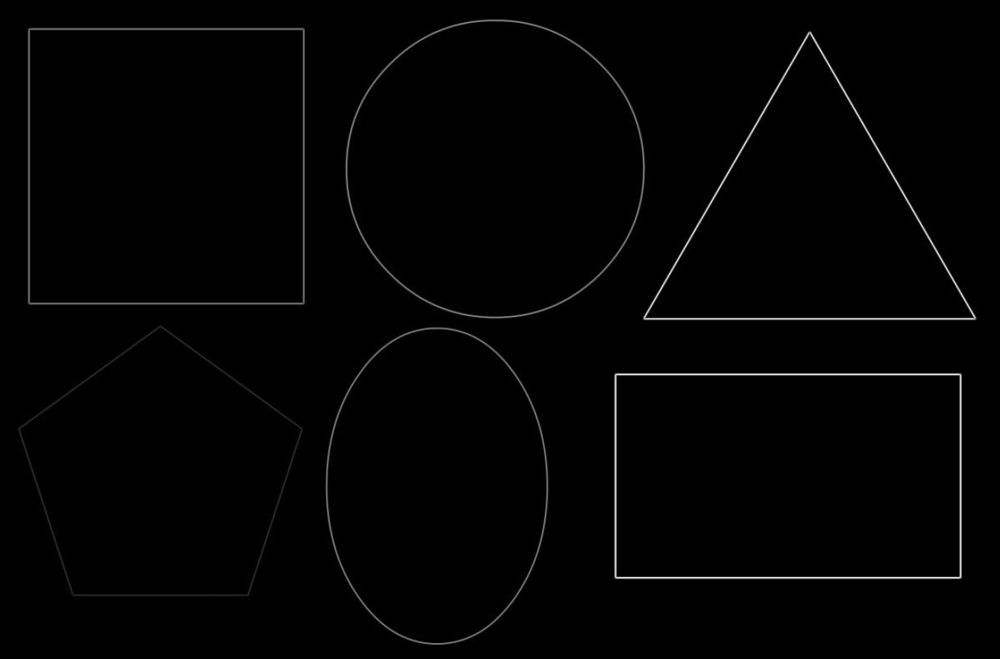

In [87]:
# charger l'image 02
image_02 = Image.open('./res/image_02.png')
pixels_02 = np.array(image_02.convert('L'))
# faites une recherche sur internet pour détecter les contours des objets dans image_02

# Apply Sobel edge detection in x and y directions
sobel_x = cv2.Sobel(pixels_02, cv2.CV_64F, 1, 0, ksize=3)  # Sobel operator for x-axis
sobel_y = cv2.Sobel(pixels_02, cv2.CV_64F, 0, 1, ksize=3)  # Sobel operator for y-axis

# Combine the gradients obtained from x and y directions
sobel_combined = cv2.sqrt(cv2.add(cv2.pow(sobel_x, 2), cv2.pow(sobel_y, 2)))

# Convert the result to 8-bit image
sobel_combined = cv2.normalize(sobel_combined, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

display(Image.fromarray(sobel_combined))

#  Compter des objets

# Challenge
Compter le nombre d'objets dans l'image 03 avec le code précédent.
- Qu'est ce que vous remarquez?
- Utiliser l'algorithme Watershed pour detecter et séparer les objets connectés.

In [ ]:
#

Bravo !